## Simulation

We have 5 blocks for our simulation experiment. 
   - Loading packages
   - Defining functions
   - Iteratively simulates
   - Conduct summary statistics 
   - Result visualization

### Block 1

In [232]:
import numpy as np
import pandas as pd
from scipy.special import expit 
from scipy.stats import beta
from statsmodels.api import GLM
from statsmodels.genmod.families import Binomial
from statsmodels.genmod.families.links import identity
import matplotlib.pyplot as plt
import seaborn as sns


--- 
### Block 2


In [287]:
# Generate Data
def generate_data_original(n=10000, prob_z4=0.2, prob_z5=0.2, prob_z6=0.2, prob_z7=0.2, intrial=True):
    data = pd.DataFrame({
        "Z1": np.random.binomial(1, 0.5, n),
        "Z2": np.random.binomial(1, 0.5, n),
        "Z3": np.random.binomial(1, 0.5, n),
        "Z4": np.random.binomial(1, prob_z4, n),
        "Z5": np.random.binomial(1, prob_z5, n),
        "Z6": np.random.binomial(1, prob_z6, n),
        "Z7": np.random.binomial(1, prob_z7, n),
        "Z8": np.random.binomial(1, 0.5, n),
        "X": np.random.binomial(1, 0.5, n),
        "intrial": int(intrial) * np.ones(n)
    })

    data["PY"] = np.clip(
        0.1 + 0.1 * data["X"] + 0.1 * data["Z2"] + 0.1 * data["Z3"] +
        0.1 * data["Z5"] + 0.1 * data["Z6"] 
        + 0.1 * data["X"] * data["Z3"] + 0.1 * data["X"] * data["Z6"], 0, 1
    )

    data["Y"] = np.random.binomial(1, data["PY"])
    data["intercept"] = 1
    return data


def generate_data_binomial(n=10000, prob_z4=0.2, prob_z5=0.2, prob_z6=0.2, prob_z7=0.2, intrial=True):
    data = pd.DataFrame({
        "Z1": np.random.binomial(1, 0.5, n),
        "Z2": np.random.binomial(1, 0.5, n),
        "Z3": np.random.binomial(1, 0.5, n),
        "Z4": np.random.binomial(1, prob_z4, n),
        "Z5": np.random.binomial(1, prob_z5, n),
        "Z6": np.random.binomial(1, prob_z6, n),
        "Z7": np.random.binomial(1, prob_z7, n),
        "Z8": np.random.binomial(1, 0.5, n),
        "intrial": int(intrial) * np.ones(n)
    })

    data["PX"] = expit(-20 + 100 * data["Z7"]  - 30 * data["Z8"])
    data["X"] = np.random.binomial(1, data["PX"])

    data["PY"] = np.clip(
        0.1 + 0.1 * data["X"] + 0.1 * data["Z2"] + 0.1 * data["Z3"] +
        0.1 * data["Z5"] + 0.1 * data["Z6"] 
        + 0.1 * data["X"] * data["Z3"] + 0.1 * data["X"] * data["Z6"], 0, 1
    )

    data["Y"] = np.random.binomial(1, data["PY"])
    data["intercept"] = 1
    return data


def generate_data_beta(n=10000, prob_z4=0.2, prob_z5=0.2, prob_z6=0.2, prob_z7=0.5, intrial=True):
    data = pd.DataFrame({
        "Z1": np.random.binomial(1, 0.5, n),
        "Z2": np.random.binomial(1, 0.5, n),
        "Z3": np.random.binomial(1, 0.5, n),
        "Z4": np.random.binomial(1, prob_z4, n),
        "Z5": np.random.binomial(1, prob_z5, n),
        "Z6": np.random.binomial(1, prob_z6, n),
        "Z7": beta.rvs(prob_z7, 3, size=n),
        "Z8": beta.rvs(3, 4, size=n),
        "intrial": int(intrial) * np.ones(n)
    })

    data["PX"] = expit(-20 + 100 * data["Z7"]  - 30 * data["Z8"])
    data["X"] = np.random.binomial(1, data["PX"])

    data["PY"] = np.clip(
        0.1 + 0.1 * data["X"] + 0.1 * data["Z2"] + 0.1 * data["Z3"] +
        0.1 * data["Z5"] + 0.1 * data["Z6"] 
        + 0.1 * data["X"] * data["Z3"] + 0.1 * data["X"] * data["Z6"], 0, 1
    )

    data["Y"] = np.random.binomial(1, data["PY"])
    data["intercept"] = 1
    return data



In [234]:
# Functions for OM model with no interaction terms
# Model Fitting
def om_model_fit(study_x0_data, study_x1_data):
    families_identity = Binomial(link=identity())
    predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z6", "Z7", "Z8"]

    fitted_models = {}

    fitted_models["model_intercept_x0"] = GLM(study_x0_data["Y"], study_x0_data[["intercept"]], family=families_identity).fit()
    fitted_models["model_intercept_x1"] = GLM(study_x1_data["Y"], study_x1_data[["intercept"]], family=families_identity).fit()
    
    for predictor in predictors:
        fitted_models[f"model_{predictor}_x0"] = GLM(study_x0_data["Y"], study_x0_data[["intercept", predictor]], family=families_identity).fit()
        fitted_models[f"model_{predictor}_x1"] = GLM(study_x1_data["Y"], study_x1_data[["intercept", predictor]], family=families_identity).fit()
        if predictor != "Z6":
            fitted_models[f"model_{predictor}Z6_x0"] = GLM(study_x0_data["Y"], study_x0_data[["intercept", predictor, "Z6"]], family=families_identity).fit()
            fitted_models[f"model_{predictor}Z6_x1"] = GLM(study_x1_data["Y"], study_x1_data[["intercept", predictor, "Z6"]], family=families_identity).fit()

    return fitted_models


# Model Predicting
def om_model_pred(fitted_models, target_data):
    predicted_data = target_data.copy()

    # Crude models
    predicted_data["intercept_x0_pred"] = fitted_models["model_intercept_x0"].predict(predicted_data[["intercept"]])
    predicted_data["intercept_x1_pred"] = fitted_models["model_intercept_x1"].predict(predicted_data[["intercept"]])
    
    
    predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z6", "Z7", "Z8"]
    
    for predictor in predictors: 
        predicted_data[f"{predictor}_x0_pred"] = fitted_models[f"model_{predictor}_x0"].predict(predicted_data[["intercept", predictor]])
        predicted_data[f"{predictor}_x1_pred"] = fitted_models[f"model_{predictor}_x1"].predict(predicted_data[["intercept", predictor]])  
        
        if predictor != "Z6": 
            predicted_data[f"{predictor}Z6_x0_pred"] = fitted_models[f"model_{predictor}Z6_x0"].predict(predicted_data[["intercept", predictor, "Z6"]])
            predicted_data[f"{predictor}Z6_x1_pred"] = fitted_models[f"model_{predictor}Z6_x1"].predict(predicted_data[["intercept", predictor, "Z6"]])
    
    return predicted_data


# Calculating RD
def om_calculate_rd(predicted_data):
    rd_values = {}

    predictors = ["intercept", "Z1", "Z2", "Z3", "Z4", "Z5", "Z6", "Z7", "Z8"]
    
    for predictor in predictors: 
        rd_values[f"rd_{predictor}"] = predicted_data[f"{predictor}_x1_pred"].mean() - predicted_data[f"{predictor}_x0_pred"].mean()
    
    for predictor in predictors:
        if predictor != "Z6" and predictor != "intercept":
            rd_values[f"rd_{predictor}Z6"] = predicted_data[f"{predictor}Z6_x1_pred"].mean() - predicted_data[f"{predictor}Z6_x0_pred"].mean()
    
    return rd_values


In [235]:
# Functions for OM model with interation terms

# Model Fitting (with interaction term Z3 and Z6)
def om_model_fit_XZ3Z6(study_data):
    study_data = study_data.copy()
    study_data["X_Z3"] = study_data["X"] * study_data["Z3"]
    study_data["X_Z6"] = study_data["X"] * study_data["Z6"]
   
    families_identity = Binomial(link=identity())
    predictors = ["Z1", "Z2", "Z4", "Z5", "Z7", "Z8"]
    fitted_models = {}
    fitted_models["model_XZ3Z6_intercept"] = GLM(study_data["Y"], study_data[["intercept", "X", "Z3", "Z6", "X_Z3", "X_Z6"]], family=families_identity).fit()
    for predictor in predictors:
        fitted_models[f"model_XZ3Z6_{predictor}"] = GLM(study_data["Y"], study_data[["intercept", "X", "Z3", "Z6", predictor, "X_Z3", "X_Z6"]], family=families_identity).fit()

    return(fitted_models)

    
# Model Fitting (with interaction term Z6 only)
def om_model_fit_XZ6(study_data):
    study_data = study_data.copy()
    study_data["X_Z6"] = study_data["X"] * study_data["Z6"]

    families_identity = Binomial(link=identity())
    predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z7", "Z8"]
    fitted_models = {}
    fitted_models["model_XZ6_intercept"] = GLM(study_data["Y"], study_data[["intercept", "X", "Z6", "X_Z6"]], family=families_identity).fit()
    
    for predictor in predictors:
        fitted_models[f"model_XZ6_{predictor}"] = GLM(study_data["Y"], study_data[["intercept", "X", "Z6", predictor, "X_Z6"]], family=families_identity).fit()
    return(fitted_models)


# Model Predicting (with interaction term Z3 and Z6)
def om_model_pred_XZ3Z6(fitted_models, target_data):
    predicted_data = target_data.copy()
    predicted_data["X1"] = 1
    predicted_data["X0"] = 0

    
    # Ensure interaction terms exist in target data
    predicted_data["X1_Z3"] = predicted_data["X1"] * predicted_data["Z3"]
    predicted_data["X1_Z6"] = predicted_data["X1"] * predicted_data["Z6"]
    predicted_data["X0_Z3"] = predicted_data["X0"] * predicted_data["Z3"]
    predicted_data["X0_Z6"] = predicted_data["X0"] * predicted_data["Z6"]
 
    # Crude models
    predicted_data["XZ3Z6_intercept_x0_pred"] = fitted_models["model_XZ3Z6_intercept"].predict(predicted_data[["intercept", "X0",  "Z3", "Z6", "X0_Z3", "X0_Z6"]])
    predicted_data["XZ3Z6_intercept_x1_pred"] = fitted_models["model_XZ3Z6_intercept"].predict(predicted_data[["intercept", "X1",  "Z3", "Z6", "X1_Z3", "X1_Z6"]])

    predictors = ["Z1", "Z2", "Z4", "Z5", "Z7", "Z8"]
    
    for predictor in predictors: 
        predicted_data[f"XZ3Z6_{predictor}_x0_pred"] = fitted_models[f"model_XZ3Z6_{predictor}"].predict(predicted_data[["intercept", "X0",  "Z3", "Z6", predictor, "X0_Z3", "X0_Z6"]])
        predicted_data[f"XZ3Z6_{predictor}_x1_pred"] = fitted_models[f"model_XZ3Z6_{predictor}"].predict(predicted_data[["intercept", "X1",  "Z3", "Z6", predictor, "X1_Z3", "X1_Z6"]]) 
        
    return(predicted_data)

# Model Predicting (with interaction term Z6 only)
def om_model_pred_XZ6(fitted_models, target_data):
    predicted_data = target_data.copy()
    predicted_data["X1"] = 1
    predicted_data["X0"] = 0

    
    # Ensure interaction terms exist in target data
    predicted_data["X1_Z6"] = predicted_data["X1"] * predicted_data["Z6"]
    predicted_data["X0_Z6"] = predicted_data["X0"] * predicted_data["Z6"]
 
    # Crude models
    predicted_data["XZ6_intercept_x0_pred"] = fitted_models["model_XZ6_intercept"].predict(predicted_data[["intercept", "X0", "Z6", "X0_Z6"]])
    predicted_data["XZ6_intercept_x1_pred"] = fitted_models["model_XZ6_intercept"].predict(predicted_data[["intercept", "X1", "Z6", "X1_Z6"]])

    predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z7", "Z8"]
    
    for predictor in predictors: 
        predicted_data[f"XZ6_{predictor}_x0_pred"] = fitted_models[f"model_XZ6_{predictor}"].predict(predicted_data[["intercept", "X0", "Z6", predictor, "X0_Z6"]])
        predicted_data[f"XZ6_{predictor}_x1_pred"] = fitted_models[f"model_XZ6_{predictor}"].predict(predicted_data[["intercept", "X1", "Z6", predictor, "X1_Z6"]]) 
    
    return(predicted_data)


# Calculate Risk Difference
def om_calculate_rd_XZ3Z6(predicted_data):
    rd_values = {}
    predictors = ["intercept", "Z1", "Z2", "Z4", "Z5", "Z7", "Z8"] 
    for predictor in predictors: 
        rd_values[f"rd_{predictor}"] = predicted_data[f"XZ3Z6_{predictor}_x1_pred"].mean() - predicted_data[f"XZ3Z6_{predictor}_x0_pred"].mean()
    return rd_values

def om_calculate_rd_XZ6(predicted_data):
    rd_values = {}
    predictors = ["intercept", "Z1", "Z2", "Z3", "Z4", "Z5", "Z7", "Z8"] 
    for predictor in predictors: 
        rd_values[f"rd_{predictor}"] = predicted_data[f"XZ6_{predictor}_x1_pred"].mean() - predicted_data[f"XZ6_{predictor}_x0_pred"].mean()
    return rd_values


In [236]:
# # Functions for OM model with interation terms for stratified X (doesn't work well)

# # Model Fitting (with interaction term Z3 and Z6)
# def om_model_fit_XZ3Z6(study_x0_data, study_x1_data):
#     study_x0_data = study_x0_data.copy()
#     study_x1_data = study_x1_data.copy()
    
#     study_x0_data["X_Z3"] = study_x0_data["X"] * study_x0_data["Z3"]
#     study_x0_data["X_Z6"] = study_x0_data["X"] * study_x0_data["Z6"]
#     study_x1_data["X_Z3"] = study_x1_data["X"] * study_x1_data["Z3"]
#     study_x1_data["X_Z6"] = study_x1_data["X"] * study_x1_data["Z6"]

#     families_identity = Binomial(link=identity())

#     predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z6", "Z7", "Z8"]

#     fitted_models = {}

#     fitted_models["model_XZ3Z6_intercept_x0"] = GLM(study_x0_data["Y"], study_x0_data[["intercept", "X_Z3", "X_Z6"]], family=families_identity).fit()
#     fitted_models["model_XZ3Z6_intercept_x1"] = GLM(study_x1_data["Y"], study_x1_data[["intercept", "X_Z3", "X_Z6"]], family=families_identity).fit()
    
#     for predictor in predictors:
#         fitted_models[f"model_XZ3Z6_{predictor}_x0"] = GLM(study_x0_data["Y"], study_x0_data[["intercept", predictor, "X_Z3", "X_Z6"]], family=families_identity).fit()
#         fitted_models[f"model_XZ3Z6_{predictor}_x1"] = GLM(study_x1_data["Y"], study_x1_data[["intercept", predictor, "X_Z3", "X_Z6"]], family=families_identity).fit()

#     return(fitted_models)

    
# # Model Fitting (with interaction term Z6 only)
# def om_model_fit_XZ6(study_x0_data, study_x1_data):
#     study_x0_data = study_x0_data.copy()
#     study_x1_data = study_x1_data.copy()
    
#     study_x0_data["X_Z6"] = study_x0_data["X"] * study_x0_data["Z6"]
#     study_x1_data["X_Z6"] = study_x1_data["X"] * study_x1_data["Z6"]

#     families_identity = Binomial(link=identity())

#     predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z6", "Z7", "Z8"]

#     fitted_models = {}

#     fitted_models["model_XZ6_intercept_x0"] = GLM(study_x0_data["Y"], study_x0_data[["intercept", "X_Z6"]], family=families_identity).fit()
#     fitted_models["model_XZ6_intercept_x1"] = GLM(study_x1_data["Y"], study_x1_data[["intercept", "X_Z6"]], family=families_identity).fit()
    
#     for predictor in predictors:
#         fitted_models[f"model_XZ6_{predictor}_x0"] = GLM(study_x0_data["Y"], study_x0_data[["intercept", predictor, "X_Z6"]], family=families_identity).fit()
#         fitted_models[f"model_XZ6_{predictor}_x1"] = GLM(study_x1_data["Y"], study_x1_data[["intercept", predictor, "X_Z6"]], family=families_identity).fit()

#     return(fitted_models)


# # Model Predicting (with interaction term Z3 and Z6)
# def om_model_pred_XZ3Z6(fitted_models, target_data):
#     predicted_data = target_data.copy()
    
#     # Ensure interaction terms exist in target data
#     predicted_data["X_Z3"] = predicted_data["X"] * predicted_data["Z3"]
#     predicted_data["X_Z6"] = predicted_data["X"] * predicted_data["Z6"]
 
#     # Crude models
#     predicted_data["XZ3Z6_intercept_x0_pred"] = fitted_models["model_XZ3Z6_intercept_x0"].predict(predicted_data[["intercept", "X_Z3", "X_Z6"]])
#     predicted_data["XZ3Z6_intercept_x1_pred"] = fitted_models["model_XZ3Z6_intercept_x1"].predict(predicted_data[["intercept", "X_Z3", "X_Z6"]])

#     predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z6", "Z7", "Z8"]
    
#     for predictor in predictors: 
#         predicted_data[f"XZ3Z6_{predictor}_x0_pred"] = fitted_models[f"model_XZ3Z6_{predictor}_x0"].predict(predicted_data[["intercept", predictor, "X_Z3", "X_Z6"]])
#         predicted_data[f"XZ3Z6_{predictor}_x1_pred"] = fitted_models[f"model_XZ3Z6_{predictor}_x1"].predict(predicted_data[["intercept", predictor, "X_Z3", "X_Z6"]]) 
        
#     return(predicted_data)

# # Model Predicting (with interaction term Z6 only)
# def om_model_pred_XZ6(fitted_models, target_data):
#     predicted_data = target_data.copy()
    
#     # Ensure interaction terms exist in target data
#     predicted_data["X_Z6"] = predicted_data["X"] * predicted_data["Z6"]
 
#     # Crude models
#     predicted_data["XZ6_intercept_x0_pred"] = fitted_models["model_XZ6_intercept_x0"].predict(predicted_data[["intercept", "X_Z6"]])
#     predicted_data["XZ6_intercept_x1_pred"] = fitted_models["model_XZ6_intercept_x1"].predict(predicted_data[["intercept", "X_Z6"]])

#     predictors = ["Z1", "Z2", "Z3", "Z4", "Z5", "Z6", "Z7", "Z8"]
    
#     for predictor in predictors: 
#         predicted_data[f"XZ6_{predictor}_x0_pred"] = fitted_models[f"model_XZ6_{predictor}_x0"].predict(predicted_data[["intercept", predictor, "X_Z6"]])
#         predicted_data[f"XZ6_{predictor}_x1_pred"] = fitted_models[f"model_XZ6_{predictor}_x1"].predict(predicted_data[["intercept", predictor, "X_Z6"]]) 
        
#     return(predicted_data)


# # Calculate Risk Difference
# def om_calculate_rd_XZ3Z6(predicted_data):
#     rd_values = {}
#     predictors = ["intercept", "Z1", "Z2", "Z4", "Z5", "Z7", "Z8"] 
#     for predictor in predictors: 
#         rd_values[f"rd_{predictor}"] = predicted_data[f"XZ3Z6_{predictor}_x1_pred"].mean() - predicted_data[f"XZ3Z6_{predictor}_x0_pred"].mean()
#     return rd_values

# def om_calculate_rd_XZ6(predicted_data):
#     rd_values = {}
#     predictors = ["intercept", "Z1", "Z2", "Z3", "Z4", "Z5", "Z7", "Z8"] 
#     for predictor in predictors: 
#         rd_values[f"rd_{predictor}"] = predicted_data[f"XZ6_{predictor}_x1_pred"].mean() - predicted_data[f"XZ6_{predictor}_x0_pred"].mean()
#     return rd_values


In [237]:
# Functions for IOW Model with no interaction terms (not used in the report)

def iow_model_study(study_data, target_data):
    full_data = pd.concat([study_data, target_data])
    families_identity = Binomial(link=identity())
    # Models
    model_iosw_z1 = GLM(full_data["intrial"], full_data[["Z1"]], family=families_identity).fit()
    model_iosw_z2 = GLM(full_data["intrial"], full_data[["Z2"]], family=families_identity).fit()
    model_iosw_z3 = GLM(full_data["intrial"], full_data[["Z3"]], family=families_identity).fit()
    model_iosw_z4 = GLM(full_data["intrial"], full_data[["Z4"]], family=families_identity).fit()
    model_iosw_z5 = GLM(full_data["intrial"], full_data[["Z5"]], family=families_identity).fit()
    model_iosw_z6 = GLM(full_data["intrial"], full_data[["Z6"]], family=families_identity).fit()
    model_iosw_z7 = GLM(full_data["intrial"], full_data[["Z7"]], family=families_identity).fit()
    model_iosw_z8 = GLM(full_data["intrial"], full_data[["Z8"]], family=families_identity).fit()
    model_iosw_z1z6 = GLM(full_data["intrial"], full_data[["Z1", "Z6"]], family=families_identity).fit()
    model_iosw_z2z6 = GLM(full_data["intrial"], full_data[["Z2", "Z6"]], family=families_identity).fit()
    model_iosw_z3z6 = GLM(full_data["intrial"], full_data[["Z3", "Z6"]], family=families_identity).fit()
    model_iosw_z4z6 = GLM(full_data["intrial"], full_data[["Z4", "Z6"]], family=families_identity).fit()
    model_iosw_z5z6 = GLM(full_data["intrial"], full_data[["Z5", "Z6"]], family=families_identity).fit()
    model_iosw_z7z6 = GLM(full_data["intrial"], full_data[["Z7", "Z6"]], family=families_identity).fit()
    model_iosw_z8z6 = GLM(full_data["intrial"], full_data[["Z8", "Z6"]], family=families_identity).fit()

    # Predictions for study data
    study_data['pred_z1'] = model_iosw_z1.predict(study_data[["Z1"]])
    study_data['pred_z2'] = model_iosw_z2.predict(study_data[["Z2"]])
    study_data['pred_z3'] = model_iosw_z3.predict(study_data[["Z3"]])
    study_data['pred_z4'] = model_iosw_z4.predict(study_data[["Z4"]])
    study_data['pred_z5'] = model_iosw_z5.predict(study_data[["Z5"]])
    study_data['pred_z6'] = model_iosw_z6.predict(study_data[["Z6"]])
    study_data['pred_z7'] = model_iosw_z7.predict(study_data[["Z7"]])  
    study_data['pred_z8'] = model_iosw_z8.predict(study_data[["Z8"]])  

    study_data['pred_z1z6'] = model_iosw_z1z6.predict(study_data[["Z1", "Z6"]])
    study_data['pred_z2z6'] = model_iosw_z2z6.predict(study_data[["Z2", "Z6"]])
    study_data['pred_z3z6'] = model_iosw_z3z6.predict(study_data[["Z3", "Z6"]])
    study_data['pred_z4z6'] = model_iosw_z4z6.predict(study_data[["Z4", "Z6"]])
    study_data['pred_z5z6'] = model_iosw_z5z6.predict(study_data[["Z5", "Z6"]])
    study_data['pred_z7z6'] = model_iosw_z7z6.predict(study_data[["Z7", "Z6"]])  
    study_data['pred_z8z6'] = model_iosw_z8z6.predict(study_data[["Z8", "Z6"]])  
    
    # Calculate weights
    study_data['iosw_z1'] = 1 / (study_data['pred_z1'] / (1 - study_data['pred_z1']))
    study_data['iosw_z2'] = 1 / (study_data['pred_z2'] / (1 - study_data['pred_z2']))
    study_data['iosw_z3'] = 1 / (study_data['pred_z3'] / (1 - study_data['pred_z3']))
    study_data['iosw_z4'] = 1 / (study_data['pred_z4'] / (1 - study_data['pred_z4']))
    study_data['iosw_z5'] = 1 / (study_data['pred_z5'] / (1 - study_data['pred_z5']))
    study_data['iosw_z6'] = 1 / (study_data['pred_z6'] / (1 - study_data['pred_z6']))
    study_data['iosw_z7'] = 1 / (study_data['pred_z7'] / (1 - study_data['pred_z7']))
    study_data['iosw_z8'] = 1 / (study_data['pred_z8'] / (1 - study_data['pred_z8']))
    study_data['iosw_z1z6'] = 1 / (study_data['pred_z1z6'] / (1 - study_data['pred_z1z6']))
    study_data['iosw_z2z6'] = 1 / (study_data['pred_z2z6'] / (1 - study_data['pred_z2z6']))
    study_data['iosw_z3z6'] = 1 / (study_data['pred_z3z6'] / (1 - study_data['pred_z3z6']))
    study_data['iosw_z4z6'] = 1 / (study_data['pred_z4z6'] / (1 - study_data['pred_z4z6']))
    study_data['iosw_z5z6'] = 1 / (study_data['pred_z5z6'] / (1 - study_data['pred_z5z6']))
    study_data['iosw_z7z6'] = 1 / (study_data['pred_z7z6'] / (1 - study_data['pred_z7z6']))
    study_data['iosw_z8z6'] = 1 / (study_data['pred_z8z6'] / (1 - study_data['pred_z8z6']))

    return study_data



def iow_model_pred(study_data, target_data):
    families_identity = Binomial(link=identity())
    model_iow_z1 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z1"]).fit()
    model_iow_z2 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z2"]).fit()
    model_iow_z3 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z3"]).fit()
    model_iow_z4 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z4"]).fit()
    model_iow_z5 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z5"]).fit()
    model_iow_z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z6"]).fit()
    model_iow_z7 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z7"]).fit()
    model_iow_z8 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z8"]).fit()
    model_iow_z1z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z1z6"]).fit()
    model_iow_z2z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z2z6"]).fit()
    model_iow_z3z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z3z6"]).fit()
    model_iow_z4z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z4z6"]).fit()
    model_iow_z5z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z5z6"]).fit()
    model_iow_z7z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z7z6"]).fit()
    model_iow_z8z6 = GLM(study_data["Y"], study_data[["X"]], family=families_identity, freq_weights=study_data["iosw_z8z6"]).fit()


    # Predictions on target data
    predicted_data = target_data.copy()
    predicted_data["z1_iow_pred"] = model_iow_z1.predict(target_data[["X"]])
    predicted_data["z2_iow_pred"] = model_iow_z2.predict(target_data[["X"]])
    predicted_data["z3_iow_pred"] = model_iow_z3.predict(target_data[["X"]])
    predicted_data["z4_iow_pred"] = model_iow_z4.predict(target_data[["X"]])
    predicted_data["z5_iow_pred"] = model_iow_z5.predict(target_data[["X"]])
    predicted_data["z6_iow_pred"] = model_iow_z6.predict(target_data[["X"]])
    predicted_data["z7_iow_pred"] = model_iow_z7.predict(target_data[["X"]])
    predicted_data["z8_iow_pred"] = model_iow_z8.predict(target_data[["X"]])
    predicted_data["z1z6_iow_pred"] = model_iow_z1z6.predict(target_data[["X"]])
    predicted_data["z2z6_iow_pred"] = model_iow_z2z6.predict(target_data[["X"]])
    predicted_data["z3z6_iow_pred"] = model_iow_z3z6.predict(target_data[["X"]])
    predicted_data["z4z6_iow_pred"] = model_iow_z4z6.predict(target_data[["X"]])
    predicted_data["z5z6_iow_pred"] = model_iow_z5z6.predict(target_data[["X"]])
    predicted_data["z7z6_iow_pred"] = model_iow_z7z6.predict(target_data[["X"]])
    predicted_data["z8z6_iow_pred"] = model_iow_z8z6.predict(target_data[["X"]])

    return predicted_data

    

# Calculate Risk Difference
def iow_calculate_rd(predicted_data):
    rd_iow_z1 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z1_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z2 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z2_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z3 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z3_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z4 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z4_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z5 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z5_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z6_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z7 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z7_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z8 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z8_iow_pred"].mean().diff().iloc[-1]


    rd_iow_z1z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z1z6_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z2z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z2z6_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z3z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z3z6_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z4z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z4z6_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z5z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z5z6_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z7z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z7z6_iow_pred"].mean().diff().iloc[-1]
    rd_iow_z8z6 = predicted_data[predicted_data["X"].isin([0, 1])].groupby("X")["z8z6_iow_pred"].mean().diff().iloc[-1]


    # Combine all results into a dictionary
    return {
        "rd_iow_z1": rd_iow_z1,
        "rd_iow_z2": rd_iow_z2,
        "rd_iow_z3": rd_iow_z3,
        "rd_iow_z4": rd_iow_z4,
        "rd_iow_z5": rd_iow_z5,
        "rd_iow_z6": rd_iow_z6,  
        "rd_iow_z7": rd_iow_z7,
        "rd_iow_z8": rd_iow_z8, 
        "rd_iow_z1z6": rd_iow_z1z6, 
        "rd_iow_z2z6": rd_iow_z2z6,
        "rd_iow_z3z6": rd_iow_z3z6,
        "rd_iow_z4z6": rd_iow_z4z6, 
        "rd_iow_z5z6": rd_iow_z5z6,
        "rd_iow_z7z6": rd_iow_z7z6, 
        "rd_iow_z8z6": rd_iow_z8z6
    }







---
### Block 3 

In [289]:
# Simulation for outcome modeling when X is random in both the Study and Target population 
om_rd_result_list_r = []
om_XZ3Z6_rd_result_list_r = []
om_XZ6_rd_result_list_r = []
true_rd_list_r = []


for i in range(500):
    study_data_r = generate_data_original(n=10000, prob_z4=0.2, prob_z5=0.2, prob_z6=0.2, prob_z7=0.2, intrial=True)
    target_data_r = generate_data_original(n=10000, prob_z4=0.8, prob_z5=0.8, prob_z6=0.8, prob_z7=0.8, intrial=False)
    study_x0_data_r = study_data_r[study_data_r["X"] == 0]
    study_x1_data_r = study_data_r[study_data_r["X"] == 1]

    # OM
    om_fitted_models_r = om_model_fit(study_x0_data_r, study_x1_data_r)
    om_predicted_data_r = om_model_pred(om_fitted_models_r, target_data_r)
    om_rd_values_r = om_calculate_rd(om_predicted_data_r)
    om_rd_result_list_r.append(om_rd_values_r)

    om_XZ3Z6_fitted_models_r = om_model_fit_XZ3Z6(study_data_r)
    om_XZ3Z6_predicted_data_r = om_model_pred_XZ3Z6(om_XZ3Z6_fitted_models_r, target_data_r)
    om_XZ3Z6_rd_values_r = om_calculate_rd_XZ3Z6(om_XZ3Z6_predicted_data_r)
    om_XZ3Z6_rd_result_list_r.append(om_XZ3Z6_rd_values_r)

    om_XZ6_fitted_models_r = om_model_fit_XZ6(study_data_r)
    om_XZ6_predicted_data_r = om_model_pred_XZ6(om_XZ6_fitted_models_r, target_data_r)
    om_XZ6_rd_values_r = om_calculate_rd_XZ6(om_XZ6_predicted_data_r)
    om_XZ6_rd_result_list_r.append(om_XZ6_rd_values_r)
    
    # True result
    true_rd_r = target_data_r.groupby("X")["PY"].mean().diff().iloc[-1]
    true_rd_list_r.append(true_rd_r)



# Combine Results
om_rd_combined_r = pd.DataFrame(om_rd_result_list_r)
om_rd_combined_r["true_rd"] = true_rd_list_r
om_XZ3Z6_rd_combined_r = pd.DataFrame(om_XZ3Z6_rd_result_list_r)
om_XZ3Z6_rd_combined_r["true_rd"] = true_rd_list_r
om_XZ6_rd_combined_r = pd.DataFrame(om_XZ6_rd_result_list_r)
om_XZ6_rd_combined_r["true_rd"] = true_rd_list_r


/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/families/links.py:13: FutureWarning: The identity link alias is deprecated. Use Identity instead. The identity link alias will be removed after the 0.15.0 release.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__} link function "
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__} link function "
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__

In [290]:
# Simulation for outcome modeling when X is not random, Z7 Z8 are binomial 
om_rd_result_list_bi = []
true_rd_list_bi = []
om_XZ3Z6_rd_result_list_bi = []
om_XZ6_rd_result_list_bi = []

for i in range(500):
    study_data_bi = generate_data_original(n=10000, prob_z4=0.2, prob_z5=0.2, prob_z6=0.2, prob_z7=0.2, intrial=True)
    target_data_bi = generate_data_binomial(n=10000, prob_z4=0.8, prob_z5=0.8, prob_z6=0.8, prob_z7=0.8, intrial=False)
    study_x0_data_bi = study_data_bi[study_data_bi["X"] == 0]
    study_x1_data_bi = study_data_bi[study_data_bi["X"] == 1]

    # OM
    om_fitted_models_bi = om_model_fit(study_x0_data_bi, study_x1_data_bi)
    om_predicted_data_bi = om_model_pred(om_fitted_models_bi, target_data_bi)
    om_rd_values_bi = om_calculate_rd(om_predicted_data_bi)
    om_rd_result_list_bi.append(om_rd_values_bi)

    om_XZ3Z6_fitted_models_bi = om_model_fit_XZ3Z6(study_data_bi)
    om_XZ3Z6_predicted_data_bi = om_model_pred_XZ3Z6(om_XZ3Z6_fitted_models_bi, target_data_bi)
    om_XZ3Z6_rd_values_bi = om_calculate_rd_XZ3Z6(om_XZ3Z6_predicted_data_bi)
    om_XZ3Z6_rd_result_list_bi.append(om_XZ3Z6_rd_values_bi)

    om_XZ6_fitted_models_bi = om_model_fit_XZ6(study_data_bi)
    om_XZ6_predicted_data_bi = om_model_pred_XZ6(om_XZ6_fitted_models_bi, target_data_bi)
    om_XZ6_rd_values_bi = om_calculate_rd_XZ6(om_XZ6_predicted_data_bi)
    om_XZ6_rd_result_list_bi.append(om_XZ6_rd_values_bi)
    
    
    # True result
    true_rd_bi = target_data_bi.groupby("X")["PY"].mean().diff().iloc[-1]
    true_rd_list_bi.append(true_rd_bi)
    

# Combine Results
om_rd_combined_bi = pd.DataFrame(om_rd_result_list_bi)
om_rd_combined_bi["true_rd"] = true_rd_list_bi
om_XZ3Z6_rd_combined_bi = pd.DataFrame(om_XZ3Z6_rd_result_list_bi)
om_XZ3Z6_rd_combined_bi["true_rd"] = true_rd_list_bi
om_XZ6_rd_combined_bi = pd.DataFrame(om_XZ6_rd_result_list_bi)
om_XZ6_rd_combined_bi["true_rd"] = true_rd_list_bi


/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/families/links.py:13: FutureWarning: The identity link alias is deprecated. Use Identity instead. The identity link alias will be removed after the 0.15.0 release.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__} link function "
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__} link function "
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__

In [291]:
# Simulation for outcome modeling when X is not random, and Z7 Z8 are beta 
om_rd_result_list_be = []
true_rd_list_be = []
om_XZ3Z6_rd_result_list_be = []
om_XZ6_rd_result_list_be = []

for i in range(500):
    study_data_be = generate_data_original(n=10000, prob_z4=0.2, prob_z5=0.2, prob_z6=0.2, prob_z7=0.2, intrial=True)
    target_data_be = generate_data_beta(n=10000, prob_z4=0.8, prob_z5=0.8, prob_z6=0.8, prob_z7=0.8, intrial=False)
    study_x0_data_be = study_data_be[study_data_be["X"] == 0]
    study_x1_data_be = study_data_be[study_data_be["X"] == 1]

    # OM
    om_fitted_models_be = om_model_fit(study_x0_data_be, study_x1_data_be)
    om_predicted_data_be = om_model_pred(om_fitted_models_be, target_data_be)
    om_rd_values_be = om_calculate_rd(om_predicted_data_be)
    om_rd_result_list_be.append(om_rd_values_be)

    om_XZ3Z6_fitted_models_be = om_model_fit_XZ3Z6(study_data_be)
    om_XZ3Z6_predicted_data_be = om_model_pred_XZ3Z6(om_XZ3Z6_fitted_models_be, target_data_be)
    om_XZ3Z6_rd_values_be = om_calculate_rd_XZ3Z6(om_XZ3Z6_predicted_data_be)
    om_XZ3Z6_rd_result_list_be.append(om_XZ3Z6_rd_values_be)

    om_XZ6_fitted_models_be = om_model_fit_XZ6(study_data_be)
    om_XZ6_predicted_data_be = om_model_pred_XZ6(om_XZ6_fitted_models_be, target_data_be)
    om_XZ6_rd_values_be = om_calculate_rd_XZ6(om_XZ6_predicted_data_be)
    om_XZ6_rd_result_list_be.append(om_XZ6_rd_values_be)
    
    
    # True result
    true_rd_be = target_data_be.groupby("X")["PY"].mean().diff().iloc[-1]
    true_rd_list_be.append(true_rd_be)
    

# Combine Results
om_rd_combined_be = pd.DataFrame(om_rd_result_list_be)
om_rd_combined_be["true_rd"] = true_rd_list_be
om_XZ3Z6_rd_combined_be = pd.DataFrame(om_XZ3Z6_rd_result_list_be)
om_XZ3Z6_rd_combined_be["true_rd"] = true_rd_list_be
om_XZ6_rd_combined_be = pd.DataFrame(om_XZ6_rd_result_list_be)
om_XZ6_rd_combined_be["true_rd"] = true_rd_list_be


/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/families/links.py:13: FutureWarning: The identity link alias is deprecated. Use Identity instead. The identity link alias will be removed after the 0.15.0 release.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__} link function "
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__} link function "
/opt/anaconda3/lib/python3.12/site-packages/statsmodels/genmod/generalized_linear_model.py:308: DomainWarning: The identity link function does not respect the domain of the Binomial family.
  warnings.warn((f"The {type(family.link).__name__

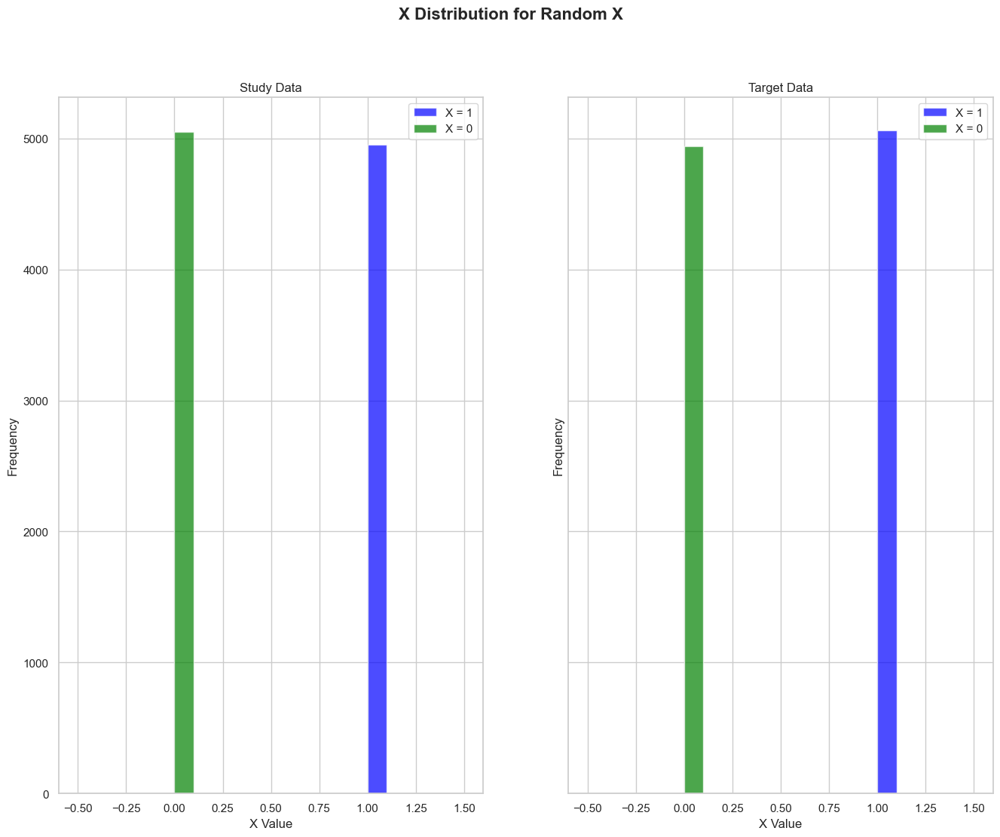

,Dataset,Mean_X,Variance_X
0,Study Data,0.4951,0.250001
1,Target Data,0.5060,0.249989


In [241]:
# Plot X distribution for random X
# Filter the trial data by treatment assignment 
target_x1_r = target_data_r[target_data_r["X"] == 1]
target_x0_r = target_data_r[target_data_r["X"] == 0]

# Plot 
fig, axes = plt.subplots(1, 2, figsize=(16, 12), sharey=True)
fig.suptitle("X Distribution for Random X", fontsize=16, fontweight='bold')


# First subplot (Study Data)
axes[0].hist(study_x1_data_r["X"], bins=10, alpha=0.7, label="X = 1", color="blue")
axes[0].hist(study_x0_data_r["X"], bins=10, alpha=0.7, label="X = 0", color="green")
axes[0].set_xlabel("X Value")
axes[0].set_ylabel("Frequency")
axes[0].set_title("Study Data")
axes[0].legend()

# Second subplot (Target Data)
axes[1].hist(target_x1_r["X"], bins=10, alpha=0.7, label="X = 1", color="blue")
axes[1].hist(target_x0_r["X"], bins=10, alpha=0.7, label="X = 0", color="green")
axes[1].set_xlabel("X Value")
axes[1].set_ylabel("Frequency")
axes[1].set_title("Target Data")
axes[1].legend()

# Show the figure
plt.show()

##############################################################


# Dictionary to store the results
results_r = {"Dataset": [], "Mean_X": [], "Variance_X": []}

datasets_r = {
    "Study Data": study_data_r,
    "Target Data": target_data_r,
}

# Loop through each dataset and calculate mean and variance
for name, df in datasets_r.items():
    mean_x = df["X"].mean()
    var_x = df["X"].var()
    results_r["Dataset"].append(name)
    results_r["Mean_X"].append(mean_x)
    results_r["Variance_X"].append(var_x)

# Convert the results dictionary into a DataFrame
df_results_r = pd.DataFrame(results_r)

# Display the resulting DataFrame
df_results_r

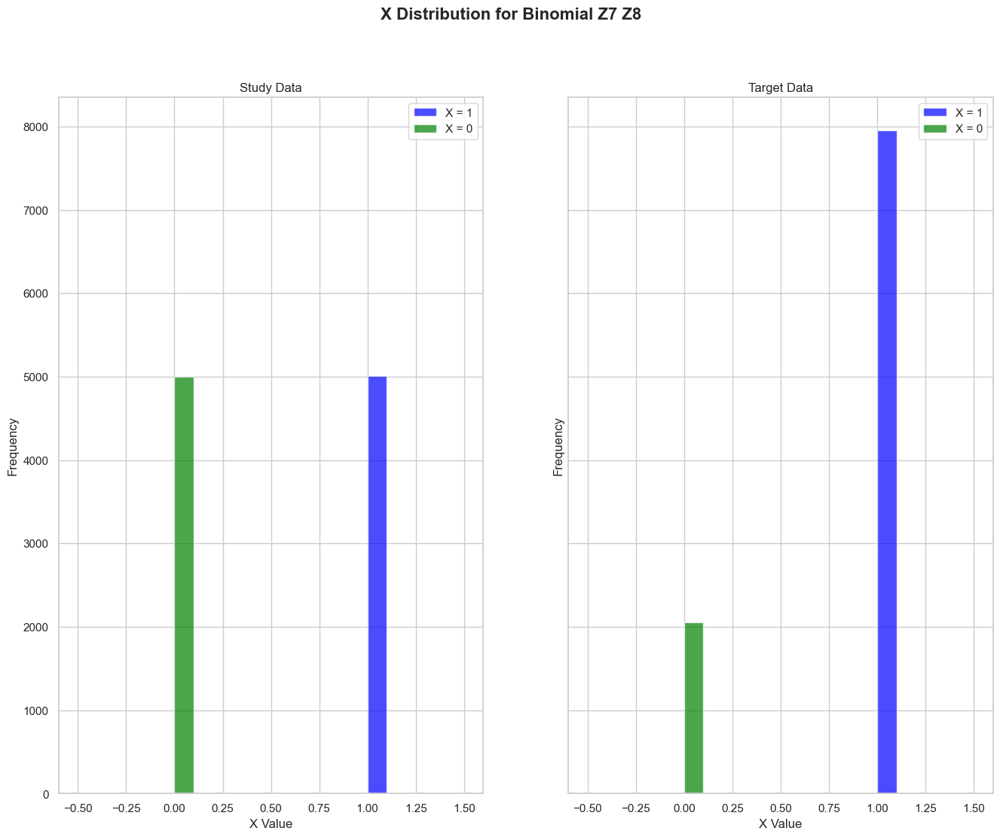

,Dataset,Mean_X,Variance_X
0,Study Data,0.5005,0.250025
1,Target Data,0.7951,0.162932


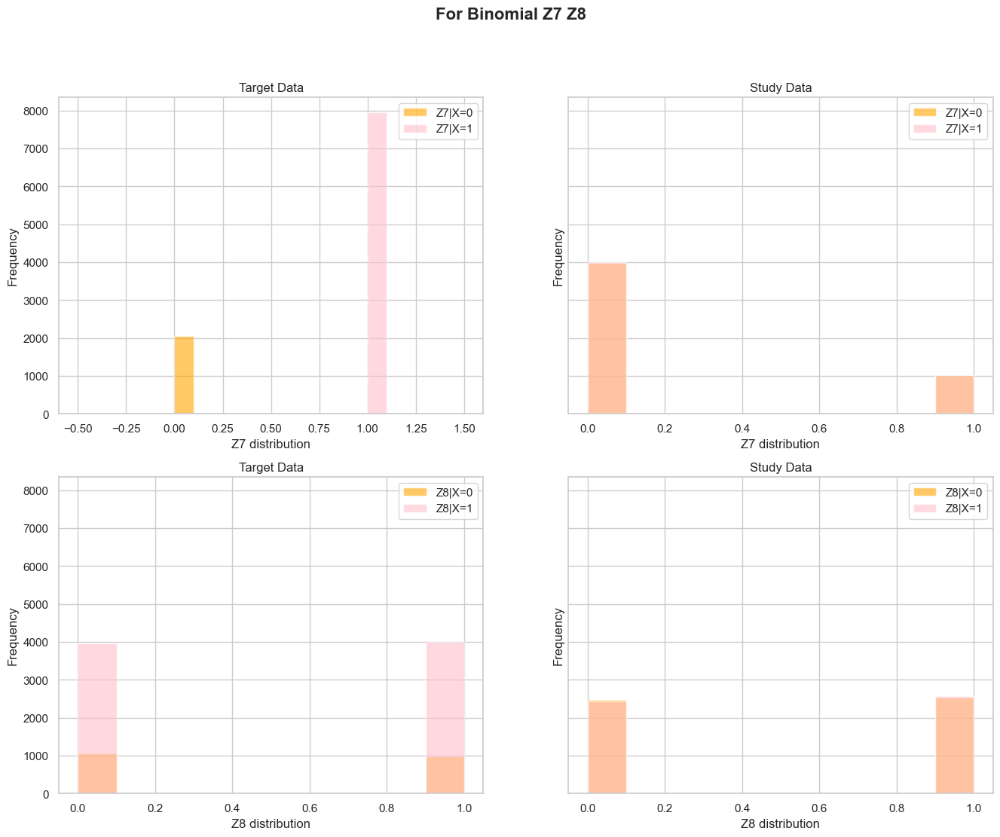

In [242]:
# Plot X distribution for binomial Z7 Z8
# Filter the trial data by treatment assignment 
target_x1_bi = target_data_bi[target_data_bi["X"] == 1]
target_x0_bi = target_data_bi[target_data_bi["X"] == 0]

# Plot 
fig, axes = plt.subplots(1, 2, figsize=(16, 12), sharey=True)
fig.suptitle("X Distribution for Binomial Z7 Z8", fontsize=16, fontweight='bold')


# First subplot (Study Data)
axes[0].hist(study_x1_data_bi["X"], bins=10, alpha=0.7, label="X = 1", color="blue")
axes[0].hist(study_x0_data_bi["X"], bins=10, alpha=0.7, label="X = 0", color="green")
axes[0].set_xlabel("X Value")
axes[0].set_ylabel("Frequency")
axes[0].set_title("Study Data")
axes[0].legend()

# Second subplot (Target Data)
axes[1].hist(target_x1_bi["X"], bins=10, alpha=0.7, label="X = 1", color="blue")
axes[1].hist(target_x0_bi["X"], bins=10, alpha=0.7, label="X = 0", color="green")
axes[1].set_xlabel("X Value")
axes[1].set_ylabel("Frequency")
axes[1].set_title("Target Data")
axes[1].legend()

# Show the figure
plt.show()

##############################################################
fig, axes = plt.subplots(2, 2, figsize=(16, 12), sharey=True)
fig.suptitle("For Binomial Z7 Z8", fontsize=16, fontweight='bold')

axes[0,0].hist(target_x0_bi["Z7"], bins=10, alpha=0.6, label= "Z7|X=0", color="orange")
axes[0,0].hist(target_x1_bi["Z7"], bins=10, alpha=0.6, label= "Z7|X=1", color="pink")
axes[0,0].set_xlabel("Z7 distribution")
axes[0,0].set_ylabel("Frequency")
axes[0,0].set_title("Target Data")
axes[0,0].legend()

axes[0,1].hist(study_x0_data_bi["Z7"], bins=10, alpha=0.6, label= "Z7|X=0", color="orange")
axes[0,1].hist(study_x1_data_bi["Z7"], bins=10, alpha=0.6, label= "Z7|X=1", color="pink")
axes[0,1].set_xlabel("Z7 distribution")
axes[0,1].set_ylabel("Frequency")
axes[0,1].set_title("Study Data")
axes[0,1].legend()

axes[1,0].hist(target_x0_bi["Z8"], bins=10, alpha=0.6, label= "Z8|X=0", color="orange")
axes[1,0].hist(target_x1_bi["Z8"], bins=10, alpha=0.6, label= "Z8|X=1", color="pink")
axes[1,0].set_xlabel("Z8 distribution")
axes[1,0].set_ylabel("Frequency")
axes[1,0].set_title("Target Data")
axes[1,0].legend()

axes[1,1].hist(study_x0_data_bi["Z8"], bins=10, alpha=0.6, label= "Z8|X=0", color="orange")
axes[1,1].hist(study_x1_data_bi["Z8"], bins=10, alpha=0.6, label= "Z8|X=1", color="pink")
axes[1,1].set_xlabel("Z8 distribution")
axes[1,1].set_ylabel("Frequency")
axes[1,1].set_title("Study Data")
axes[1,1].legend()



# Dictionary to store the results
results_bi = {"Dataset": [], "Mean_X": [], "Variance_X": []}

datasets_bi = {
    "Study Data": study_data_bi,
    "Target Data": target_data_bi,
}

# Loop through each dataset and calculate mean and variance
for name, df in datasets_bi.items():
    mean_x = df["X"].mean()
    var_x = df["X"].var()
    results_bi["Dataset"].append(name)
    results_bi["Mean_X"].append(mean_x)
    results_bi["Variance_X"].append(var_x)

# Convert the results dictionary into a DataFrame
df_results_bi = pd.DataFrame(results_bi)

# Display the resulting DataFrame
df_results_bi

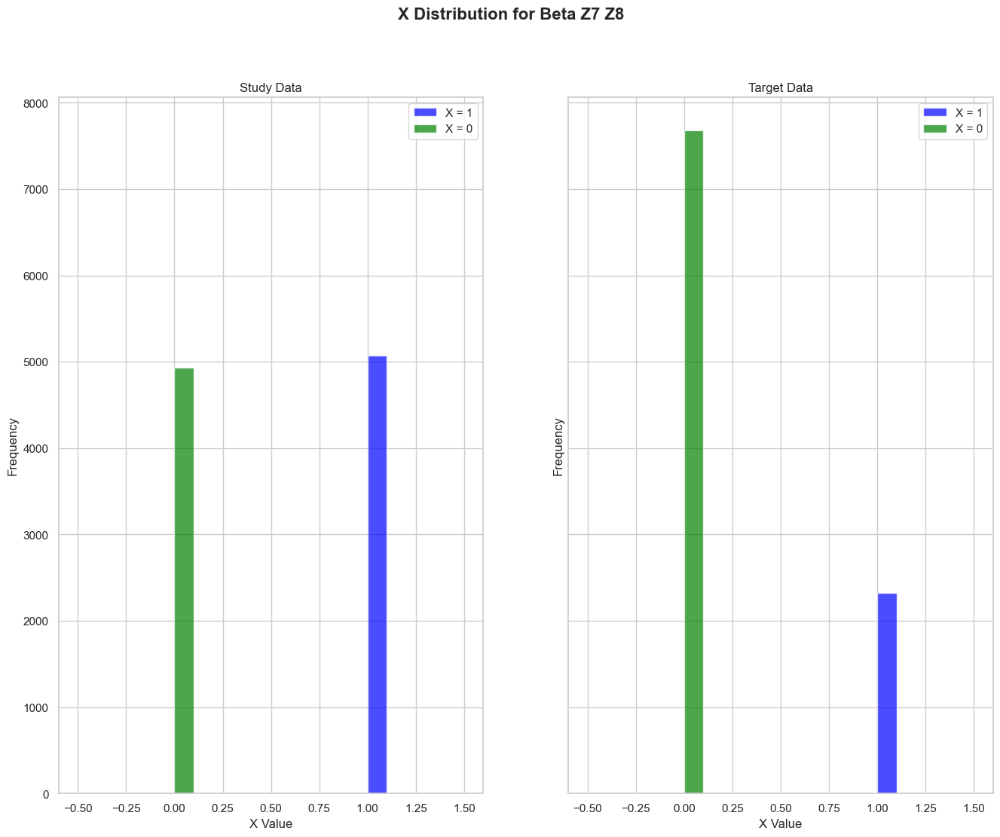

,Dataset,Mean_X,Variance_X
0,Study Data,0.5068,0.249979
1,Target Data,0.2322,0.178301


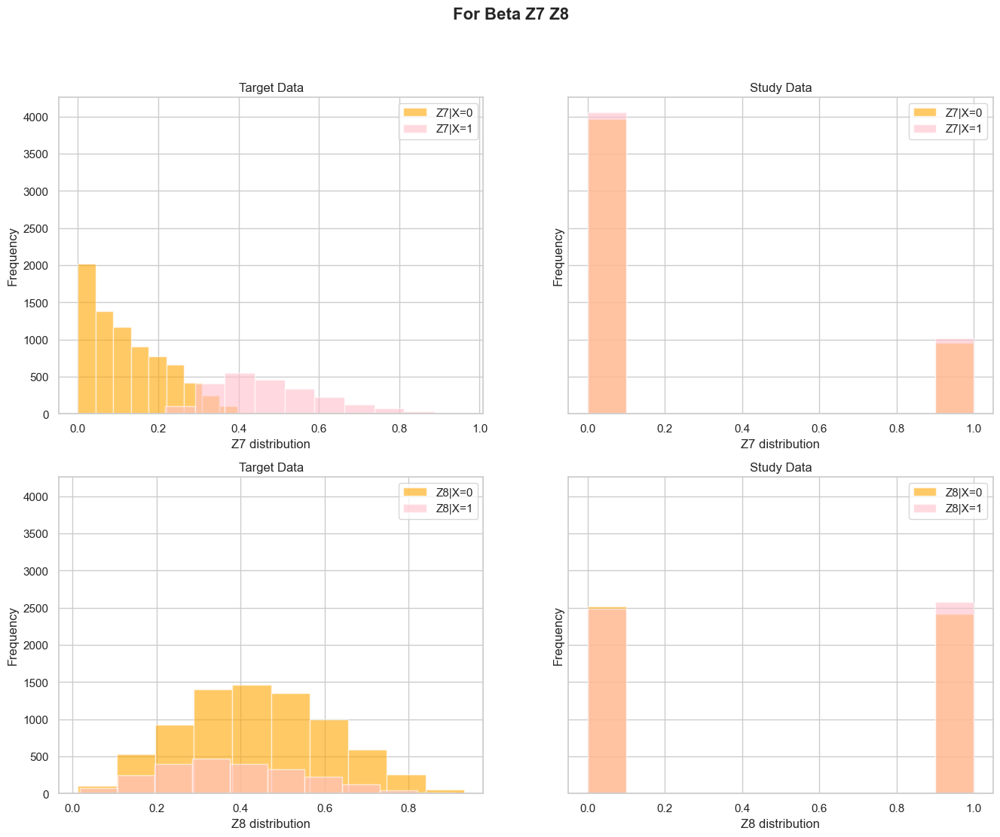

In [259]:
# Plot X distribution for beta Z7 Z8
# Filter the trial data by treatment assignment 
target_x1_be = target_data_be[target_data_be["X"] == 1]
target_x0_be = target_data_be[target_data_be["X"] == 0]

# Plot 
fig, axes = plt.subplots(1, 2, figsize=(16, 12), sharey=True)
fig.suptitle("X Distribution for Beta Z7 Z8", fontsize=16, fontweight='bold')


# First subplot (Study Data)
axes[0].hist(study_x1_data_be["X"], bins=10, alpha=0.7, label="X = 1", color="blue")
axes[0].hist(study_x0_data_be["X"], bins=10, alpha=0.7, label="X = 0", color="green")
axes[0].set_xlabel("X Value")
axes[0].set_ylabel("Frequency")
axes[0].set_title("Study Data")
axes[0].legend()

# Second subplot (Target Data)
axes[1].hist(target_x1_be["X"], bins=10, alpha=0.7, label="X = 1", color="blue")
axes[1].hist(target_x0_be["X"], bins=10, alpha=0.7, label="X = 0", color="green")
axes[1].set_xlabel("X Value")
axes[1].set_ylabel("Frequency")
axes[1].set_title("Target Data")
axes[1].legend()

# Show the figure
plt.show()

##############################################################
fig, axes = plt.subplots(2, 2, figsize=(16, 12), sharey=True)
fig.suptitle("For Beta Z7 Z8", fontsize=16, fontweight='bold')

axes[0,0].hist(target_x0_be["Z7"], bins=10, alpha=0.6, label= "Z7|X=0", color="orange")
axes[0,0].hist(target_x1_be["Z7"], bins=10, alpha=0.6, label= "Z7|X=1", color="pink")
axes[0,0].set_xlabel("Z7 distribution")
axes[0,0].set_ylabel("Frequency")
axes[0,0].set_title("Target Data")
axes[0,0].legend()

axes[0,1].hist(study_x0_data_be["Z7"], bins=10, alpha=0.6, label= "Z7|X=0", color="orange")
axes[0,1].hist(study_x1_data_be["Z7"], bins=10, alpha=0.6, label= "Z7|X=1", color="pink")
axes[0,1].set_xlabel("Z7 distribution")
axes[0,1].set_ylabel("Frequency")
axes[0,1].set_title("Study Data")
axes[0,1].legend()

axes[1,0].hist(target_x0_be["Z8"], bins=10, alpha=0.6, label= "Z8|X=0", color="orange")
axes[1,0].hist(target_x1_be["Z8"], bins=10, alpha=0.6, label= "Z8|X=1", color="pink")
axes[1,0].set_xlabel("Z8 distribution")
axes[1,0].set_ylabel("Frequency")
axes[1,0].set_title("Target Data")
axes[1,0].legend()

axes[1,1].hist(study_x0_data_be["Z8"], bins=10, alpha=0.6, label= "Z8|X=0", color="orange")
axes[1,1].hist(study_x1_data_be["Z8"], bins=10, alpha=0.6, label= "Z8|X=1", color="pink")
axes[1,1].set_xlabel("Z8 distribution")
axes[1,1].set_ylabel("Frequency")
axes[1,1].set_title("Study Data")
axes[1,1].legend()



# Dictionary to store the results
results_be = {"Dataset": [], "Mean_X": [], "Variance_X": []}

datasets_be = {
    "Study Data": study_data_be,
    "Target Data": target_data_be,
}

# Loop through each dataset and calculate mean and variance
for name, df in datasets_be.items():
    mean_x = df["X"].mean()
    var_x = df["X"].var()
    results_be["Dataset"].append(name)
    results_be["Mean_X"].append(mean_x)
    results_be["Variance_X"].append(var_x)

# Convert the results dictionary into a DataFrame
df_results_be = pd.DataFrame(results_be)

# Display the resulting DataFrame
df_results_be

---
### Block 4

In [305]:
# Summary Statistics
om_summary_stats_r = om_rd_combined_r.agg(["mean", "std"]).T
om_summary_stats_r["mse"] = ((om_rd_combined_r.sub(om_rd_combined_r["true_rd"], axis=0))**2).mean()
om_XZ3Z6_summary_stats_r = om_XZ3Z6_rd_combined_r.agg(["mean", "std"]).T
om_XZ3Z6_summary_stats_r["mse"] = ((om_XZ3Z6_rd_combined_r.sub(om_XZ3Z6_rd_combined_r["true_rd"], axis=0))**2).mean()
om_XZ6_summary_stats_r = om_XZ6_rd_combined_r.agg(["mean", "std"]).T
om_XZ6_summary_stats_r["mse"] = ((om_XZ6_rd_combined_r.sub(om_XZ6_rd_combined_r["true_rd"], axis=0))**2).mean()

om_summary_stats_bi = om_rd_combined_bi.agg(["mean", "std"]).T
om_summary_stats_bi["mse"] = ((om_rd_combined_bi.sub(om_rd_combined_bi["true_rd"], axis=0))**2).mean()
om_XZ3Z6_summary_stats_bi = om_XZ3Z6_rd_combined_bi.agg(["mean", "std"]).T
om_XZ3Z6_summary_stats_bi["mse"] = ((om_XZ3Z6_rd_combined_bi.sub(om_XZ3Z6_rd_combined_bi["true_rd"], axis=0))**2).mean()
om_XZ6_summary_stats_bi = om_XZ6_rd_combined_bi.agg(["mean", "std"]).T
om_XZ6_summary_stats_bi["mse"] = ((om_XZ6_rd_combined_bi.sub(om_XZ6_rd_combined_bi["true_rd"], axis=0))**2).mean()

om_summary_stats_be = om_rd_combined_be.agg(["mean", "std"]).T
om_summary_stats_be["mse"] = ((om_rd_combined_be.sub(om_rd_combined_be["true_rd"], axis=0))**2).mean()
om_XZ3Z6_summary_stats_be = om_XZ3Z6_rd_combined_be.agg(["mean", "std"]).T
om_XZ3Z6_summary_stats_be["mse"] = ((om_XZ3Z6_rd_combined_be.sub(om_XZ3Z6_rd_combined_be["true_rd"], axis=0))**2).mean()
om_XZ6_summary_stats_be = om_XZ6_rd_combined_be.agg(["mean", "std"]).T
om_XZ6_summary_stats_be["mse"] = ((om_XZ6_rd_combined_be.sub(om_XZ6_rd_combined_be["true_rd"], axis=0))**2).mean()



---
### Block 5

In [293]:
# Function to style the table
def style_table_without_model_column(df, title):
    # Gradient for the `mse` column (blue, dark for smallest)
    mse_colors = (
        df["mse"]
        .rank(method="min", ascending=True, na_option="bottom")
        .apply(lambda x: f"background-color: rgba(0, 0, 255, {0.4 - 0.3 * (x / df['mse'].rank(method='min', na_option='bottom').max())})" if pd.notna(x) else "")
    )
    
    # Gradient for the `std` column (purple, dark for smallest)
    std_colors = (
        df["std"]
        .rank(method="min", ascending=True, na_option="bottom")
        .apply(lambda x: f"background-color: rgba(128, 0, 128, {0.4 - 0.3 * (x / df['std'].rank(method='min', na_option='bottom').max())})" if pd.notna(x) else "")
    )
    
    # Bold the last row (assumed to be `true_rd`, last in the DataFrame)
    def bold_last_row(row):
        return ["font-weight: bold"] * len(row) if row.name == df.index[-1] else [""] * len(row)
    
    # Apply styles
    return (
        df.style
        .apply(lambda _: mse_colors, subset=["mse"])
        .apply(lambda _: std_colors, subset=["std"])
        .apply(bold_last_row, axis=1)  # Bold the last row
        .set_caption(f"<b>{title}</b>")  # Set table title
    )

# Apply the styles
om_styled_summary_df_r = style_table_without_model_column(om_summary_stats_r, "Result when X Random, with no Interaction Term")
om_XZ3Z6_styled_summary_df_r = style_table_without_model_column(om_XZ3Z6_summary_stats_r, "Result when X Random, with Z3 and Z6 Interaction terms")
om_XZ6_styled_summary_df_r = style_table_without_model_column(om_XZ6_summary_stats_r, "Result when X Random, with Z6 Interaction term")

om_styled_summary_df_bi = style_table_without_model_column(om_summary_stats_bi, "Result when X not Random (Z7 Z8 Binomial), with no Interaction Term")
om_XZ3Z6_styled_summary_df_bi = style_table_without_model_column(om_XZ3Z6_summary_stats_bi, "Result when X not Random (Z7 Z8 Binomial), with Z3 and Z6 Interaction terms")
om_XZ6_styled_summary_df_bi = style_table_without_model_column(om_XZ6_summary_stats_bi, "Result when X not Random (Z7 Z8 Binomial), with Z6 Interaction term")

om_styled_summary_df_be = style_table_without_model_column(om_summary_stats_be, "Result when X not Random (Z7 Z8 Beta), with no Interaction Term")
om_XZ3Z6_styled_summary_df_be = style_table_without_model_column(om_XZ3Z6_summary_stats_be, "Result when X not Random (Z7 Z8 Beta), with Z3 and Z6 Interaction terms")
om_XZ6_styled_summary_df_be = style_table_without_model_column(om_XZ6_summary_stats_be, "Result when X not Random (Z7 Z8 Beta), with Z6 Interaction term")



In [294]:
# Display Results
om_styled_summary_df_r
#om_XZ3Z6_styled_summary_df_r
#om_XZ6_styled_summary_df_r

#om_styled_summary_df_bi
#om_XZ3Z6_styled_summary_df_bi
#om_XZ6_styled_summary_df_bi

#om_styled_summary_df_be
#om_XZ3Z6_styled_summary_df_be
#om_XZ6_styled_summary_df_be

,mean,std,mse
rd_intercept,0.170562,0.009168,0.003599
rd_Z1,0.170558,0.009159,0.003599
rd_Z2,0.170503,0.009073,0.003605
rd_Z3,0.170478,0.009092,0.003607
rd_Z4,0.171365,0.016907,0.003707
rd_Z5,0.169702,0.017343,0.003916
rd_Z6,0.230057,0.016880,0.000293
rd_Z7,0.169443,0.016776,0.003934
rd_Z8,0.170560,0.009173,0.003600
rd_Z1Z6,0.230048,0.016875,0.000293


In [295]:
om_styled_summary_df_r

,mean,std,mse
rd_intercept,0.170562,0.009168,0.003599
rd_Z1,0.170558,0.009159,0.003599
rd_Z2,0.170503,0.009073,0.003605
rd_Z3,0.170478,0.009092,0.003607
rd_Z4,0.171365,0.016907,0.003707
rd_Z5,0.169702,0.017343,0.003916
rd_Z6,0.230057,0.016880,0.000293
rd_Z7,0.169443,0.016776,0.003934
rd_Z8,0.170560,0.009173,0.003600
rd_Z1Z6,0.230048,0.016875,0.000293


In [296]:
om_XZ6_styled_summary_df_r

,mean,std,mse
rd_intercept,0.230057,0.016880,0.000293
rd_Z1,0.230054,0.016874,0.000293
rd_Z2,0.230019,0.016496,0.000280
rd_Z3,0.227767,0.016678,0.000290
rd_Z4,0.230047,0.016883,0.000293
rd_Z5,0.229972,0.016830,0.000291
rd_Z7,0.230063,0.016886,0.000293
rd_Z8,0.230052,0.016886,0.000293
true_rd,0.229778,0.002371,0.000000


In [297]:
om_XZ3Z6_styled_summary_df_r

,mean,std,mse
rd_intercept,0.230338,0.016748,0.000288
rd_Z1,0.230339,0.016740,0.000288
rd_Z2,0.230214,0.016374,0.000276
rd_Z4,0.230328,0.016749,0.000288
rd_Z5,0.230279,0.016679,0.000286
rd_Z7,0.230341,0.016756,0.000288
rd_Z8,0.230329,0.016752,0.000288
true_rd,0.229778,0.002371,0.000000


In [298]:
# Big table (parallel for randomX, non-randomX) 

def style_table_by_col_index_with_gradient(df):
    """
    1) Round all values to 4 decimals.
    2) Highlight specific columns (by integer index) with a light-to-dark gradient 
       based on column values (bigger value => darker color).
    3) Bold the last row.
    """

    # Start by creating a Styler and formatting to 4 decimal places
    s = df.style.format("{:.4f}")

    def gradient_color(col, base_rgb=(173, 216, 230)):
        """
        Apply a gradient to a column from light to dark.
        :param col: A column (pd.Series).
        :param base_rgb: The base (R,G,B) color; e.g. (173, 216, 230) ~ lightblue
        """
        # Rank in ascending order => largest value has rank = len(col)
        # => largest value => darkest color
        col_rank = col.rank(method="dense", ascending=True)
        max_rank = col_rank.max()

        styles = []
        for i, val in enumerate(col):
            if pd.isna(val):
                # No style if NaN
                styles.append("")
            else:
                # Convert rank to [0..1], bigger => closer to 1
                intensity = col_rank.iloc[i] / max_rank

                # We'll interpolate alpha from ~0.1 (light) to ~0.8 (dark) 
                # so it's visible but not fully opaque
                alpha = 0.1 + 0.7 * intensity  # ranges ~ [0.1..0.8]

                # Create the RGBA color
                r, g, b = base_rgb
                styles.append(f"background-color: rgba({r},{g},{b},{alpha:.4f})")
        return styles

    # Example usage:
    # Let's say columns [1,4,7] get a lightblue gradient
    columns_lightblue = [1, 4, 7]
    for c in columns_lightblue:
        s = s.apply(gradient_color, base_rgb=(173, 216, 230), subset=[df.columns[c]], axis=0)

    # Another example: columns [2,5,8] get a light-pink gradient
    def gradient_color_pink(col):
        return gradient_color(col, base_rgb=(255, 192, 203))  # (255,192,203) ~ pink

    columns_pink = [2, 5, 8]
    for c in columns_pink:
        s = s.apply(gradient_color_pink, subset=[df.columns[c]], axis=0)

    # Finally, make the last row bold
    def bold_last_row(row):
        return ["font-weight: bold"] * len(row) if row.name == df.index[-1] else ["" for _ in row]

    s = s.apply(bold_last_row, axis=1)

    return s


# Suppose you've combined your DataFrames into one with MultiIndex columns
combined_df = pd.concat(
    [om_summary_stats_r, om_summary_stats_bi, om_summary_stats_be], 
    axis=1, 
    keys=["Random X", "Non-Random X (Binomial Z7 Z8)", "Non-Random X (Beta Z7 Z8)"]
)

# Apply the new styling function
styled_combined_df = style_table_by_col_index_with_gradient(combined_df)
styled_combined_df.set_caption("Models with no Interaction term")

# Display in Jupyter
styled_combined_df




In [299]:
# Big table (parallel for randomX, non-randomX) with X*Z6
xz6_combined_df = pd.concat(
    [om_XZ6_summary_stats_r, om_XZ6_summary_stats_bi, om_XZ6_summary_stats_be], 
    axis=1, 
    keys=["Random X", "Non-Random X (Binomial Z7 Z8)", "Non-Random X (Beta Z7 Z8)"]
)

# Apply the new styling function
xz6_styled_combined_df = style_table_by_col_index_with_gradient(xz6_combined_df)
xz6_styled_combined_df.set_caption("Models with Interaction term X*Z6")

# Display in Jupyter
xz6_styled_combined_df

In [300]:
# Big table (parallel for randomX, non-randomX) with X*Z3 and X*Z6
xz3z6_combined_df = pd.concat(
    [om_XZ3Z6_summary_stats_r, om_XZ3Z6_summary_stats_bi, om_XZ3Z6_summary_stats_be], 
    axis=1, 
    keys=["Random X", "Non-Random X (Binomial Z7 Z8)", "Non-Random X (Beta Z7 Z8)"]
)

# Apply the new styling function
xz3z6_styled_combined_df = style_table_by_col_index_with_gradient(xz3z6_combined_df)
xz3z6_styled_combined_df.set_caption("Models with Interaction terms X*Z3 and X*Z6")

# Display in Jupyter
xz3z6_styled_combined_df

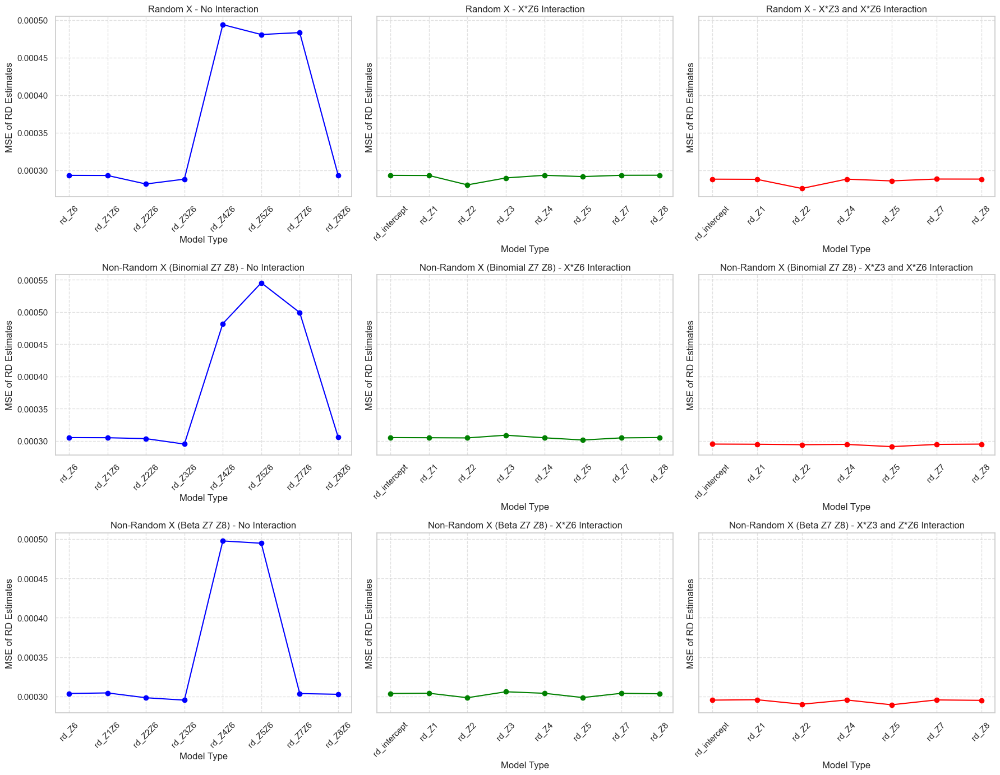

In [303]:
# Line plots for mse across different modeling strategies
fig, axes = plt.subplots(3, 3, figsize=(18, 14), sharey='row')

# First row: Random X
# Column 1: Only rows involving Z6
df1 = om_summary_stats_r[om_summary_stats_r.index.str.contains("Z6")]
axes[0, 0].plot(df1.index, df1['mse'], marker='o', linestyle='-', color='blue')
axes[0, 0].set_title("Random X - No Interaction")

# Column 2: Exclude true_rd
df2 = om_XZ6_summary_stats_r[om_XZ6_summary_stats_r.index != "true_rd"]
axes[0, 1].plot(df2.index, df2['mse'], marker='o', linestyle='-', color='green')
axes[0, 1].set_title("Random X - X*Z6 Interaction")

# Column 3: Exclude true_rd
df3 = om_XZ3Z6_summary_stats_r[om_XZ3Z6_summary_stats_r.index != "true_rd"]
axes[0, 2].plot(df3.index, df3['mse'], marker='o', linestyle='-', color='red')
axes[0, 2].set_title("Random X - X*Z3 and X*Z6 Interaction")

# Second row: Non-Random X (Binomial Z7 Z8)
# Column 1: Rows involving Z6
df4 = om_summary_stats_bi[om_summary_stats_bi.index.str.contains("Z6")]
axes[1, 0].plot(df4.index, df4['mse'], marker='o', linestyle='-', color='blue')
axes[1, 0].set_title("Non-Random X (Binomial Z7 Z8) - No Interaction")

# Column 2: Exclude true_rd
df5 = om_XZ6_summary_stats_bi[om_XZ6_summary_stats_bi.index != "true_rd"]
axes[1, 1].plot(df5.index, df5['mse'], marker='o', linestyle='-', color='green')
axes[1, 1].set_title("Non-Random X (Binomial Z7 Z8) - X*Z6 Interaction")

# Column 3: Exclude true_rd
df6 = om_XZ3Z6_summary_stats_bi[om_XZ3Z6_summary_stats_bi.index != "true_rd"]
axes[1, 2].plot(df6.index, df6['mse'], marker='o', linestyle='-', color='red')
axes[1, 2].set_title("Non-Random X (Binomial Z7 Z8) - X*Z3 and X*Z6 Interaction")

# Third row: Non-Random X (Beta Z7 Z8)
# Column 1: Rows involving Z6
df7 = om_summary_stats_be[om_summary_stats_be.index.str.contains("Z6")]
axes[2, 0].plot(df7.index, df7['mse'], marker='o', linestyle='-', color='blue')
axes[2, 0].set_title("Non-Random X (Beta Z7 Z8) - No Interaction")

# Column 2: Exclude true_rd
df8 = om_XZ6_summary_stats_be[om_XZ6_summary_stats_be.index != "true_rd"]
axes[2, 1].plot(df8.index, df8['mse'], marker='o', linestyle='-', color='green')
axes[2, 1].set_title("Non-Random X (Beta Z7 Z8) - X*Z6 Interaction")

# Column 3: Exclude true_rd
df9 = om_XZ3Z6_summary_stats_be[om_XZ3Z6_summary_stats_be.index != "true_rd"]
axes[2, 2].plot(df9.index, df9['mse'], marker='o', linestyle='-', color='red')
axes[2, 2].set_title("Non-Random X (Beta Z7 Z8) - X*Z3 and Z*Z6 Interaction")

# Formatting for all plots
for ax_row in axes:
    for ax in ax_row:
        ax.set_xlabel("Model Type")
        ax.set_ylabel("MSE of RD Estimates")
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()


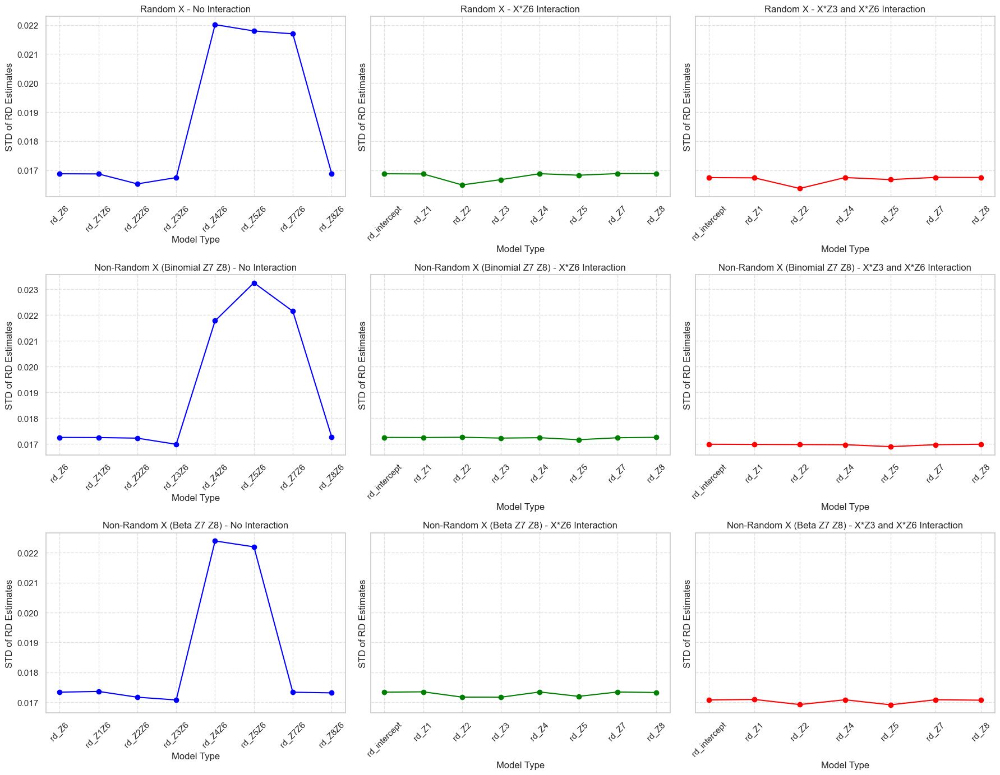

In [304]:
# Line plots for std across different modeling strategies
fig, axes = plt.subplots(3, 3, figsize=(18, 14), sharey='row')

# First row: Random X
# Column 1: Only rows involving Z6
df1 = om_summary_stats_r[om_summary_stats_r.index.str.contains("Z6")]
axes[0, 0].plot(df1.index, df1['std'], marker='o', linestyle='-', color='blue')
axes[0, 0].set_title("Random X - No Interaction")

# Column 2: Exclude true_rd
df2 = om_XZ6_summary_stats_r[om_XZ6_summary_stats_r.index != "true_rd"]
axes[0, 1].plot(df2.index, df2['std'], marker='o', linestyle='-', color='green')
axes[0, 1].set_title("Random X - X*Z6 Interaction")

# Column 3: Exclude true_rd
df3 = om_XZ3Z6_summary_stats_r[om_XZ3Z6_summary_stats_r.index != "true_rd"]
axes[0, 2].plot(df3.index, df3['std'], marker='o', linestyle='-', color='red')
axes[0, 2].set_title("Random X - X*Z3 and X*Z6 Interaction")

# Second row: Non-Random X (Binomial Z7 Z8)
# Column 1: Rows involving Z6
df4 = om_summary_stats_bi[om_summary_stats_bi.index.str.contains("Z6")]
axes[1, 0].plot(df4.index, df4['std'], marker='o', linestyle='-', color='blue')
axes[1, 0].set_title("Non-Random X (Binomial Z7 Z8) - No Interaction")

# Column 2: Exclude true_rd
df5 = om_XZ6_summary_stats_bi[om_XZ6_summary_stats_bi.index != "true_rd"]
axes[1, 1].plot(df5.index, df5['std'], marker='o', linestyle='-', color='green')
axes[1, 1].set_title("Non-Random X (Binomial Z7 Z8) - X*Z6 Interaction")

# Column 3: Exclude true_rd
df6 = om_XZ3Z6_summary_stats_bi[om_XZ3Z6_summary_stats_bi.index != "true_rd"]
axes[1, 2].plot(df6.index, df6['std'], marker='o', linestyle='-', color='red')
axes[1, 2].set_title("Non-Random X (Binomial Z7 Z8) - X*Z3 and X*Z6 Interaction")

# Third row: Non-Random X (Beta Z7 Z8)
# Column 1: Rows involving Z6
df7 = om_summary_stats_be[om_summary_stats_be.index.str.contains("Z6")]
axes[2, 0].plot(df7.index, df7['std'], marker='o', linestyle='-', color='blue')
axes[2, 0].set_title("Non-Random X (Beta Z7 Z8) - No Interaction")

# Column 2: Exclude true_rd
df8 = om_XZ6_summary_stats_be[om_XZ6_summary_stats_be.index != "true_rd"]
axes[2, 1].plot(df8.index, df8['std'], marker='o', linestyle='-', color='green')
axes[2, 1].set_title("Non-Random X (Beta Z7 Z8) - X*Z6 Interaction")

# Column 3: Exclude true_rd
df9 = om_XZ3Z6_summary_stats_be[om_XZ3Z6_summary_stats_be.index != "true_rd"]
axes[2, 2].plot(df9.index, df9['std'], marker='o', linestyle='-', color='red')
axes[2, 2].set_title("Non-Random X (Beta Z7 Z8) - X*Z3 and X*Z6 Interaction")

# Formatting for all plots
for ax_row in axes:
    for ax in ax_row:
        ax.set_xlabel("Model Type")
        ax.set_ylabel("STD of RD Estimates")
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True, linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()



